# notebook 1: make and save synthetic data, ground truth objects
_Langevin dynamics on 2d-Waddington volcano_

## imports

### mount drive

In [1]:
COLAB = False
if COLAB == True:
    drive.mount('/content/drive')

### pip installs

In [2]:
if COLAB==True:
    !pip install scanpy moscot ott-jax diffrax napari anndata -q
    !pip install "jax[cuda]" -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html -q
else:
    pass 

### set save directories

In [3]:
fh_save_data = './volcano_data_saved/'
fh_save_output = './volcano_output_saved/'
fh_save_metrics = './volcano_metrics_saved/'

print(f"save data file path: {fh_save_data}")
print(f"save output file path: {fh_save_output}")
print(f"save metrics file path: {fh_save_metrics}")

save data file path: ./volcano_data_saved/
save output file path: ./volcano_output_saved/
save metrics file path: ./volcano_metrics_saved/


### imports

In [4]:
import sys
import pathlib
import os
import random
import importlib

import pandas as pd
from anndata import AnnData
import scanpy as sc

import random
import numpy as np
from typing import Tuple
import torch

from scipy.spatial.distance import cdist
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import adjusted_mutual_info_score, adjusted_rand_score
from sklearn.cluster import KMeans
from threadpoolctl import threadpool_limits

# import plotly.graph_objects as go
import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from PIL import Image

import jax
import jax.numpy as jnp
from jax import random as jax_random
import moscot as mt
import moscot.plotting as mpl
from moscot.problems.time import TemporalProblem

### import `HM-OT`

In [5]:
if COLAB == True:
    fh_hmot = "/content/drive/Othercomputers/numac/GitHub/HM-OT" # filehandle for HM-OT
    project_root = pathlib.Path(fh_hmot)
    sys.path.insert(0, fh_hmot)
    sys.path.insert(0, str(project_root / "src"))
else: 
    fh_hmot = '../../'
    project_root = pathlib.Path(fh_hmot)
    sys.path.insert(0, fh_hmot)

import src.FRLC as FRLC
import src.FRLC.FRLC_multimarginal as FRLC_multimarginal
import src.HiddenMarkovOT as HiddenMarkovOT

import src.utils.clustering as clustering
import src.utils.util_LR as util_LR
import src.utils.util_zf as util_zf

from src.utils.util_LR import convert_adata
from src.utils.waddington import visual, minima, simulation, differentiation, metrics, landscape_core_volcano, landscape_core_tristable
# TODO: minima is currently the home of function setup_point_clouds_for_waddington_ot
from src.utils.waddington import seed_everything
from src.platting import color_utils, palette_utils, string_utils, spatial_scatter, diffmap, sankey
# import src.plotting as plotting
import experiments.differentiation_map_validation as dmv # for cosine similarity


## settings: `GLOBAL_SEED`, `device`, `dtype`

### set seed

In [6]:
# Set global seed for reproducibility
GLOBAL_SEED = 42
# np.random.seed(GLOBAL_SEED)
seed = seed_everything(GLOBAL_SEED)

🌱 Setting global seed to 42
  ✓ PyTorch seeded
  ✓ JAX PRNG key created
🌱 All available RNGs seeded.


### reload / set `device`, `dtype`

In [7]:
importlib.reload(clustering)
importlib.reload(util_LR)
importlib.reload(util_zf)
importlib.reload(HiddenMarkovOT)
importlib.reload(dmv)

<module 'experiments.differentiation_map_validation' from '/Users/normandie/Documents/GitHub/HM-OT/experiments/volcano/../../experiments/differentiation_map_validation.py'>

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'On device: {device}')
dtype = torch.float64

On device: cpu


## settings: `TIMEPOINTS`, `ASSIGNMENT_RADIUS`, `LANGEVIN` parameters

### set `TIMEPOINTS`, `LANGEVIN` parameters

In [9]:
# timepoint indices of snapshots of Langevin dynamics
TIMEPOINTS = [16, 89, 3500] # snapshots taken at these timepoints

# Langevin dynamics parameteters
LANGEVIN_n_particles = 1000 # number of partciles
LANGEVIN_N_timesteps = 4000 # number of time steps
LANGEVIN_dt = 0.2
LANGEVIN_D = 0.014

## run Langevin dynamics, get ground truth global $Q$'s and $T$'s, `Qs_gt_global` and `Ts_gt_global`
Langevin dynamics: trajectory data with no measurement noise

Assignment radius: 1.6
Verification (polar coords):
(-1.564, -2.709)  r= 3.13  θ= 240.0° → A240
( 3.128,  0.000)  r= 3.13  θ=   0.0° → A0
(-1.564,  2.709)  r= 3.13  θ= 120.0° → A120
(-4.799, -2.796)  r= 5.55  θ= 210.2° → B210
(-4.799,  2.796)  r= 5.55  θ= 149.8° → B150
( 4.821, -2.758)  r= 5.55  θ= 330.2° → B330
( 4.821,  2.758)  r= 5.55  θ=  29.8° → B30
(-0.022, -5.555)  r= 5.55  θ= 269.8° → B270
(-0.022,  5.555)  r= 5.55  θ=  90.2° → B90
(-7.705, -4.448)  r= 8.90  θ= 210.0° → C210
( 7.705, -4.448)  r= 8.90  θ= 330.0° → C330
( 7.705,  4.448)  r= 8.90  θ=  30.0° → C30
(-7.705,  4.448)  r= 8.90  θ= 150.0° → C150
(-0.000, -8.897)  r= 8.90  θ= 270.0° → C270
(-0.000,  8.897)  r= 8.90  θ=  90.0° → C90


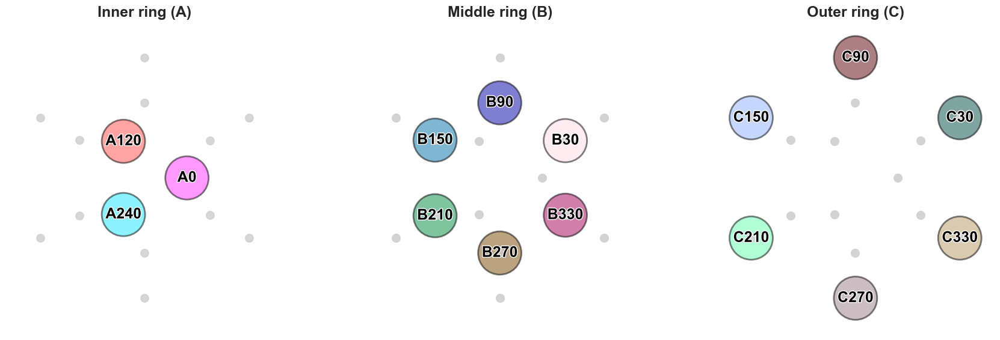


Total clusters: 15


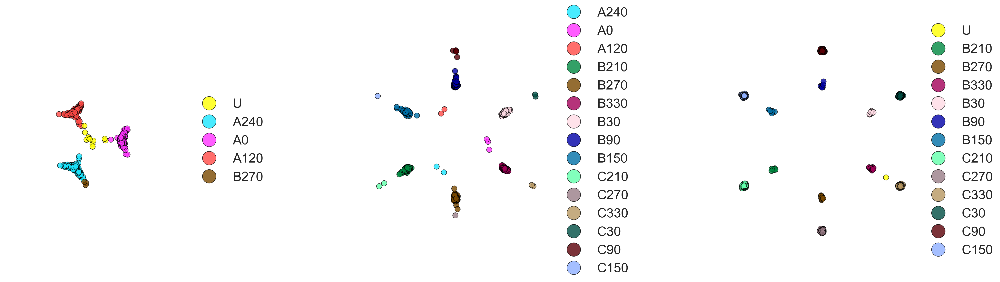

CPU times: user 5.82 s, sys: 188 ms, total: 6.01 s
Wall time: 5.98 s


In [10]:
%%time
# local minima of the Waddington landscape
# (+ ASSIGNMENT_RADIUS) determine cell type
MINIMA_POINTS = minima.find_local_minima()
ASSIGNMENT_RADIUS = 1.6

# snapshots = dynamics snapshots at each timepoint
Xs, Ys, snapshots = simulation.simulate_langevin_with_snapshots(
    n_particles=LANGEVIN_n_particles,
    n_steps=LANGEVIN_N_timesteps,
    dt=LANGEVIN_dt,
    diffusion=LANGEVIN_D,
    snap_times=TIMEPOINTS,
    rng=np.random.default_rng(GLOBAL_SEED))

# NOTE: Ss is the time series of synthetic expression data, without any measurement noise. 
Ss = [
    np.stack((Xs[:, t], Ys[:, t]), axis=1)     # shape (N, 2)
    for t in TIMEPOINTS
]

# NOTE: we make a list of all the data used in the experiment, including noise levels.
# the first element of the list is the original data, without noise.
datasets = [Ss]

# gt cell type assignments
Qs_gt_global =  minima.build_Qs(Ss, MINIMA_POINTS, ASSIGNMENT_RADIUS)

# compute gt $T$ matrices from full Qs 
Eye = np.eye(LANGEVIN_n_particles) / LANGEVIN_n_particles

T12 = Qs_gt_global[0].T @ Eye @ Qs_gt_global[1]
T23 = Qs_gt_global[1].T @ Eye @ Qs_gt_global[2]
Ts_gt_global = [T12, T23]

# construct canonical labels, colormap
STR_TO_IND_DICT_GLOBAL = { v: k \
                          for k, v in minima.IND_TO_STR_DICT_GLOBAL.items() }
_, _, _, IND_TO_COLOR_DICT_GLOBAL = palette_utils.get_diffmap_inputs(Qs_gt_global, 
                                                                     Ts_gt_global, 
                                                                     global_Qs=True)
STR_TO_COLOR_DICT_GLOBAL = {k : IND_TO_COLOR_DICT_GLOBAL[v] \
                            for k, v in STR_TO_IND_DICT_GLOBAL.items()}


CLUSTER_DICT = visual.create_cluster_dict_and_plot(
    MINIMA_POINTS,
    ASSIGNMENT_RADIUS,
    str_to_color_dict=STR_TO_COLOR_DICT_GLOBAL
)

# ─────────────────────────────────────────────────────────────────────────────────
# scatter plotting parameters

SCATTER_PAD=1.0
SCATTER_SUBPLOT_SPACING=1.0
SCATTER_FONT_SIZE=48
SCATTER_KEY_SPACING=0.25
SCATTER_DOTSIZE = 400.0
SCATTER_KEY_DOTSIZE = 1.0
LABEL_ORDER = minima.LABEL_ORDER
DOT_ALPHA = 0.8  # opacity of dots
SCATTER_OUTLINE_COLOR = "black"  # outline color for dots

spatial_scatter.plot_clusters_from_QT(
    Qs = Qs_gt_global,
    Ts = Ts_gt_global,
    Ss=Ss,
    ind_to_str_dict=minima.IND_TO_STR_DICT_GLOBAL,
    str_to_color_dict=STR_TO_COLOR_DICT_GLOBAL,
    dotsize=SCATTER_DOTSIZE,
    key_dotsize=SCATTER_KEY_DOTSIZE,
    global_Qs=True,
    fontsize=SCATTER_FONT_SIZE,
    pad=SCATTER_PAD,
    subplot_spacing=SCATTER_SUBPLOT_SPACING,
    key_spacing=SCATTER_KEY_SPACING,
    label_order=LABEL_ORDER,
    dot_alpha=DOT_ALPHA,
    outline_color=SCATTER_OUTLINE_COLOR)

## dummy plot for labels

/var/folders/53/ktzn4_5n1g15r0r9jtn9j7140000gn/T/ipykernel_30364/2498475284.py:36: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


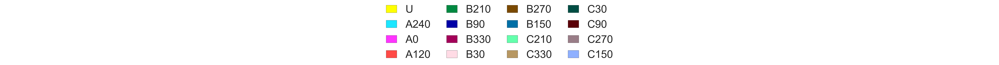

In [11]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

def draw_color_legend(
    label_list: list[str],
    color_dict: dict[str, tuple],
    *,
    title: str = "Canonical Cell Type Colors",
    ncol: int = 5,
    fontsize: int = 96,
    marker_size: int = 160,
):
    """
    Draws a standalone legend using matplotlib patches (no actual data plotted).
    """
    # Create a list of legend handles
    handles = [
        Patch(facecolor=color_dict[label], edgecolor='black', label=label)
        for label in label_list
    ]

    # Draw only the legend in a figure
    fig, ax = plt.subplots(figsize=(marker_size, 2))
    ax.legend(
        handles=handles,
        loc="center",
        ncol=ncol,
        frameon=False,
        fontsize=fontsize,
        handlelength=1,
        handletextpad=0.8,
        columnspacing=1.5,
    )
    ax.axis("off")
    # plt.title(title, fontsize=fontsize + 2)
    plt.tight_layout()
    plt.show()

canonical_order = ['U', 'A240', 'A0', 'A120', 'B210', 'B90', 'B330', 'B30', 'B270', 'B150',
                   'C210', 'C330', 'C30', 'C90', 'C270', 'C150']

draw_color_legend(canonical_order, STR_TO_COLOR_DICT_GLOBAL, ncol=4)

## set experiment parameters: `NOISE_min`, `NOISE_max`, `n_noise_levels`, `n_TIMEPOINTS`
range and number of noise levels

noise level 1 / 10: 2.0


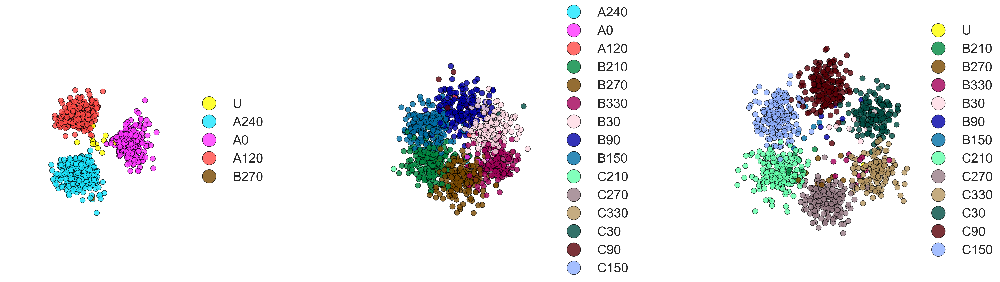

noise level 2 / 10: 2.1666666666666665


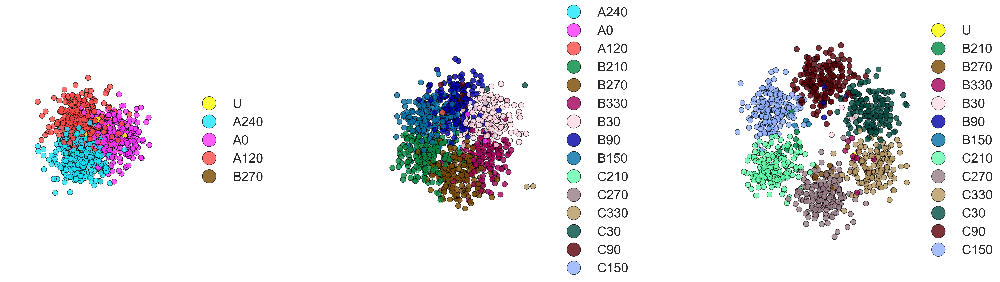

noise level 3 / 10: 2.3333333333333335


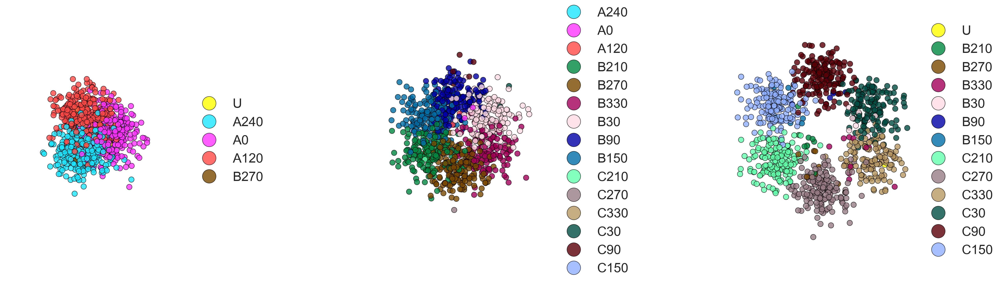

noise level 4 / 10: 2.5


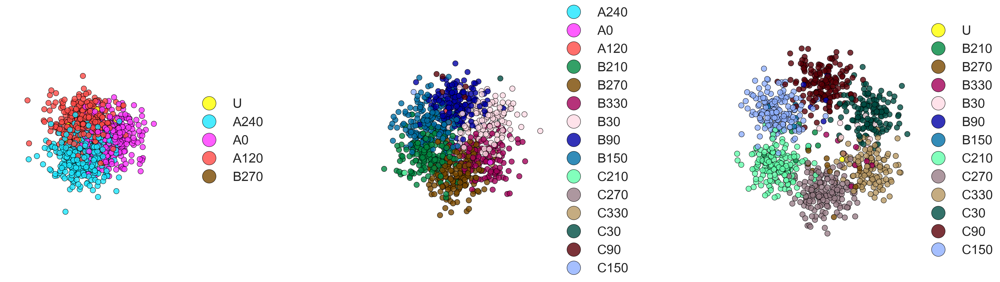

noise level 5 / 10: 2.6666666666666665


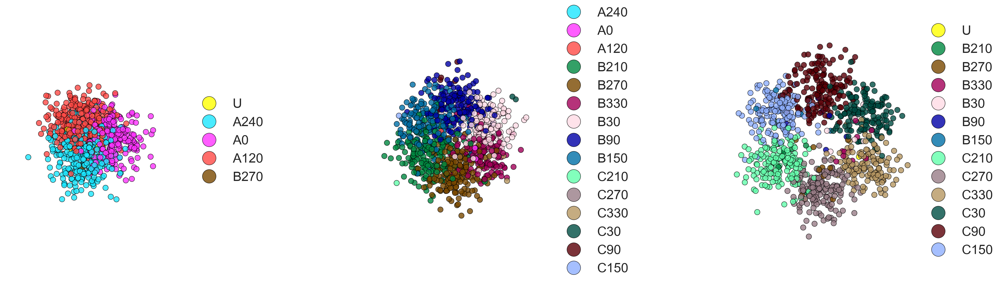

noise level 6 / 10: 2.833333333333333


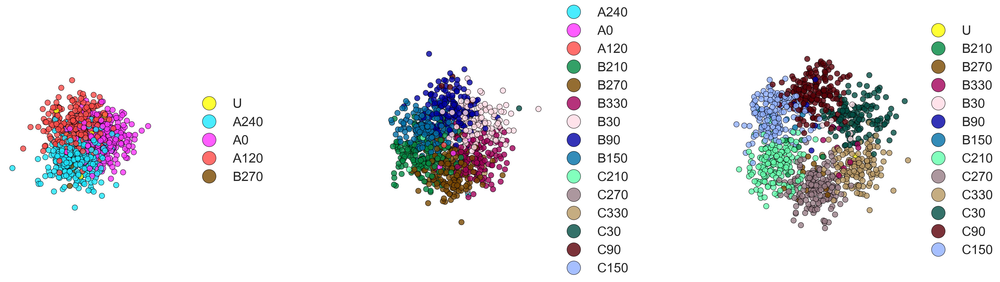

noise level 7 / 10: 3.0


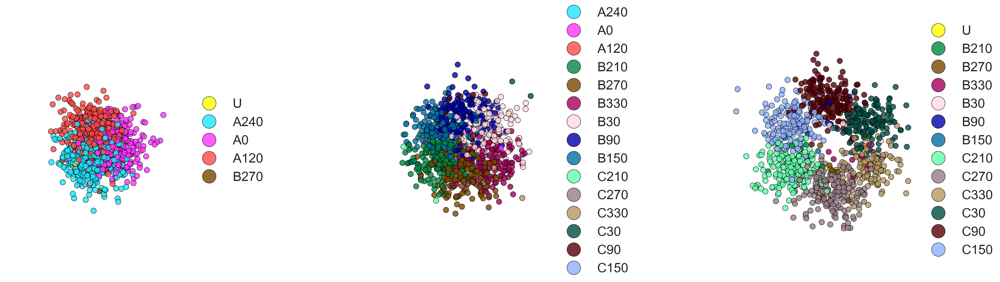

noise level 8 / 10: 3.1666666666666665


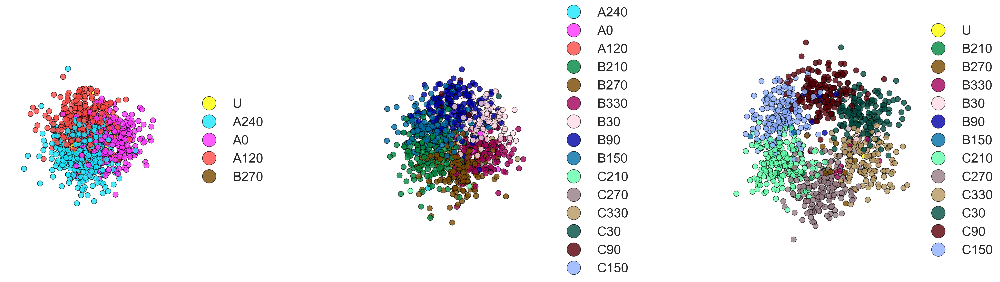

noise level 9 / 10: 3.333333333333333


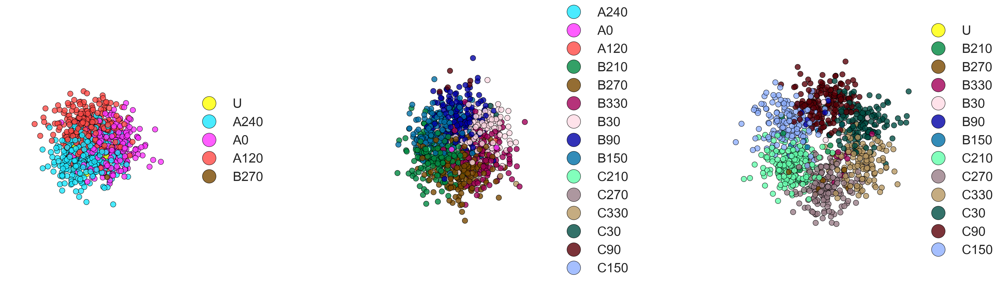

noise level 10 / 10: 3.5


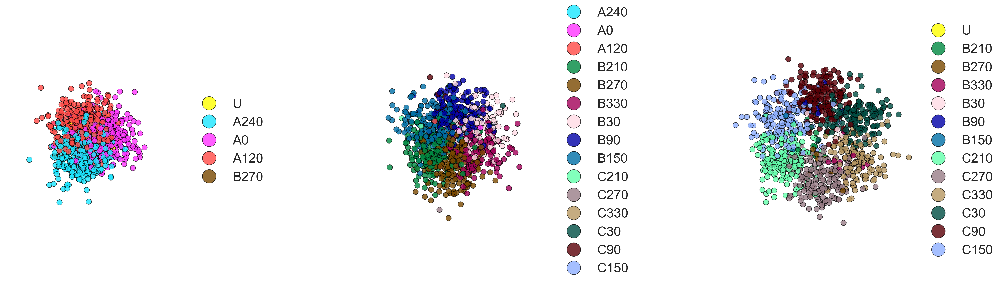

In [12]:
# Constants
STD = 1.0
NOISE_min = 2.0 * STD
NOISE_max = 3.5 * STD
n_TIMEPOINTS = len(TIMEPOINTS)  # Assuming TIMEPOINTS is defined elsewhere
n_noise_levels = 10

# Initialize random number generator with seed
rng = np.random.default_rng(GLOBAL_SEED)

# Generate noise levels
noise_level_range = np.linspace(NOISE_min, NOISE_max, n_noise_levels)

# Generate base random matrices using seeded RNG
# Shape: (n_noise_levels, n_timepoints, n_particles, 2)
base_matrices = rng.normal(
    loc=0.0,
    scale=1.0,
    size=(n_noise_levels, n_TIMEPOINTS, LANGEVIN_n_particles, 2)
)

# Scale matrices by their respective noise levels
# This broadcasts the noise levels across the appropriate dimensions
scaled_matrices = base_matrices * noise_level_range[:, np.newaxis, np.newaxis, np.newaxis]

# Create dictionary mapping noise levels to their matrices
matrices = {}
for i, level in enumerate(noise_level_range):
    # Each entry is a list of matrices for each timepoint
    matrices[level] = [scaled_matrices[i, t] for t in range(n_TIMEPOINTS)]

# Convert to list if needed (indexed by noise level order)
matrix_list = [matrices[level] for level in noise_level_range]

# NOTE: this is the main loop in which datasets with varying degrees of noise are created.
# Each dataset is a time series of noisy expression data.
# The first dataset in the list is the original data, without noise.
for i, level in enumerate(noise_level_range):
    print(f'noise level {i+1} / {len(noise_level_range)}: {level}')
    Ss_noisy = [ S + matrices[level][t] for t, S in enumerate(Ss) ]
    datasets.append(Ss_noisy)
    spatial_scatter.plot_clusters_from_QT(
        Qs = Qs_gt_global,
        Ts = Ts_gt_global,
        Ss=Ss_noisy,
        ind_to_str_dict=minima.IND_TO_STR_DICT_GLOBAL,
        str_to_color_dict=STR_TO_COLOR_DICT_GLOBAL,
        dotsize=SCATTER_DOTSIZE,
        key_dotsize=SCATTER_KEY_DOTSIZE,
        global_Qs=True,
        fontsize=SCATTER_FONT_SIZE,
        pad=SCATTER_PAD,
        subplot_spacing=SCATTER_SUBPLOT_SPACING,
        key_spacing=SCATTER_KEY_SPACING,
        label_order=LABEL_ORDER,
        dot_alpha=DOT_ALPHA,
        outline_color=SCATTER_OUTLINE_COLOR)

In [13]:
len(datasets)  # should be 11, including the original data without noise

11

##  set `RANK_LIST`, establish ground truth diffmap

### compute gt labels and proportions with `THRESHOLD`, below which we remove cell types. This determines `RANK_LIST`.

In [14]:
n_timepoints = len(TIMEPOINTS)
THRESHOLD = 20.0 # population threshold, below which we remove cell types
pops_prime = []
for Q in Qs_gt_global:
    ct_pops_ = Q.sum(axis=0)
    ct_pops_ = ct_pops_[ct_pops_ > THRESHOLD]  # Filter
    pops_prime.append(ct_pops_)

print(f"There are {pops_prime[0].sum()} cells in primary cell types at first timepoint")
print(f"There are {pops_prime[1].sum()} cells in primary cell types at second timepoint")
print(f"There are {pops_prime[2].sum()} cells in primary cell types at third timepoint")

num_ct = [ len(pop) for pop in pops_prime ]

RANK_LIST = [(num_ct[0], num_ct[1]), (num_ct[1], num_ct[2])]
print(f"RANK_LIST: {RANK_LIST}")

There are 986.0 cells in primary cell types at first timepoint
There are 980.0 cells in primary cell types at second timepoint
There are 948.0 cells in primary cell types at third timepoint
RANK_LIST: [(3, 6), (6, 6)]


### plot `Ts_gt_global`

In [15]:
Ts_gt_global[0].sum()

np.float64(1.0000000000000007)

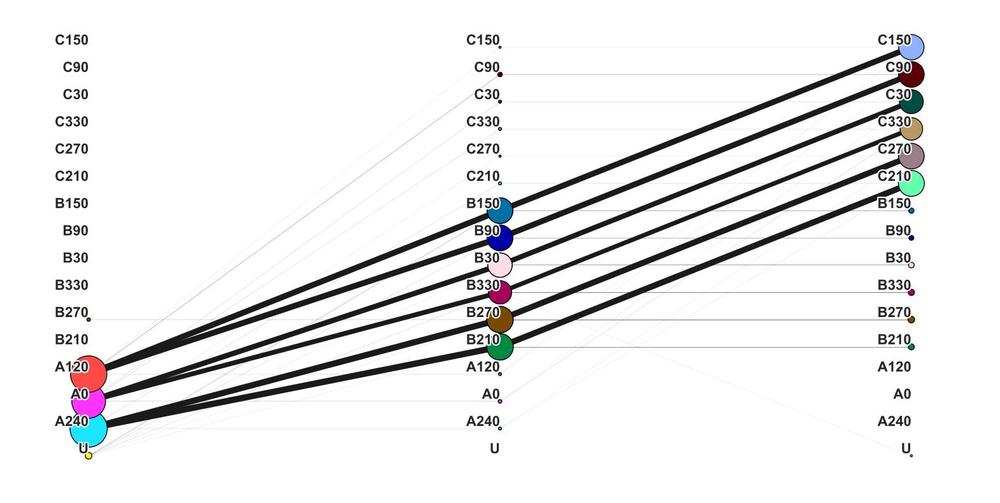

In [16]:
# ─────────────────────────────────────────────────────────────────────────────────
# diffmap plotting parameters
LINETHICK_FACTOR = 40
GLOBAL_DIFFMAP_DOTSIZE = 5.0
GLOBAL_DIFFMAP_FONTSIZE = 16
GLOBAL_DIFFMAP_STRETCH = 2.0
GLOBAL_DIFFMAP_OUTLINE = 3.0

diffmap.diffmap_from_QT(Qs_gt_global, 
                        Ts_gt_global, 
                        global_Qs=True,  
                        ind_to_str_dict=minima.IND_TO_STR_DICT_GLOBAL, 
                        str_to_color_dict=STR_TO_COLOR_DICT_GLOBAL,
                        dotsize=GLOBAL_DIFFMAP_DOTSIZE,
                        linethick_factor=LINETHICK_FACTOR,
                        fontsize=GLOBAL_DIFFMAP_FONTSIZE,
                        stretch=GLOBAL_DIFFMAP_STRETCH,
                        outline=GLOBAL_DIFFMAP_OUTLINE,
                        label_order=LABEL_ORDER,
                        stagger=True)

## getting reduced diffmap

915.0
915.0
total mass of first T filtered: 0.9999999999999998


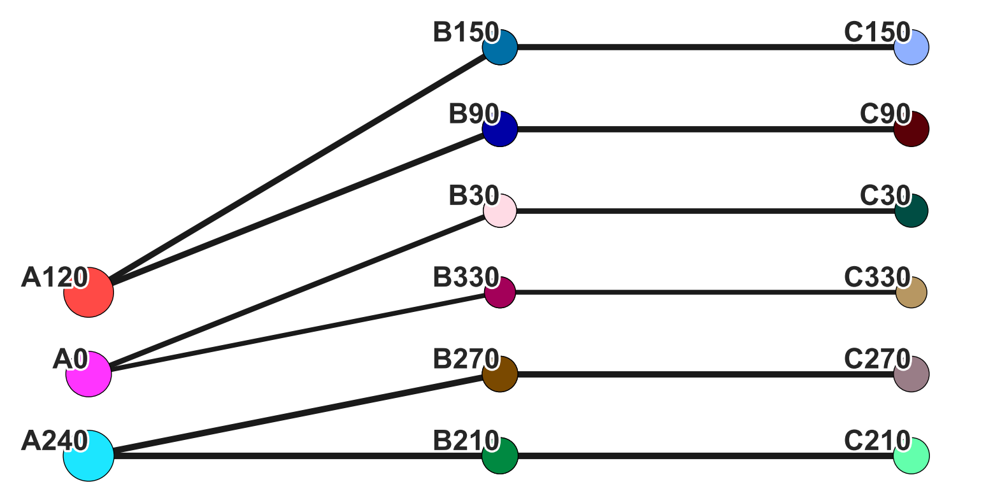

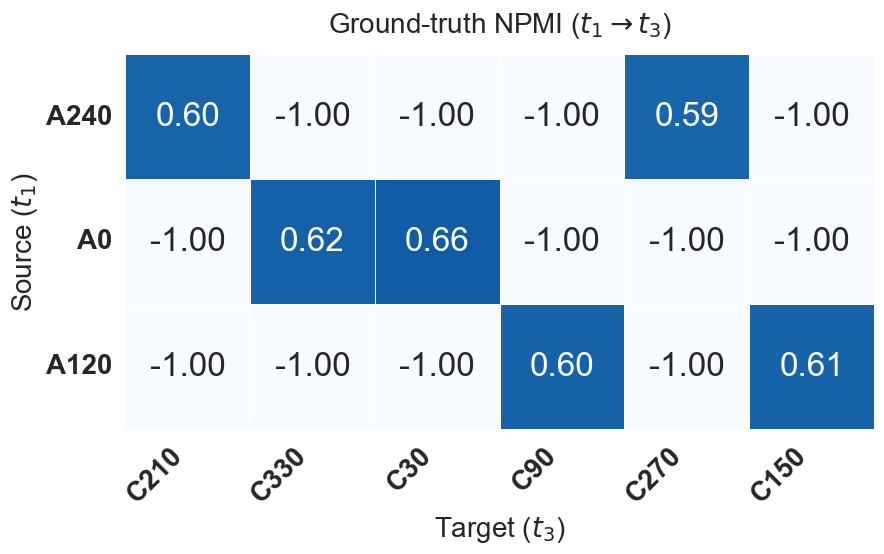

In [17]:
def NPMI_t1_to_t3_matrix(Qs, Ts, labels_Q):
    """
    Compute full matrix of NPMI scores between clusters at timepoint 1 and timepoint 3

    Args:
        Qs: List of soft assignment matrices [Q0, Q1, Q2]
        Ts: List of transition matrices [T01, T12]
        labels_Q: List of string label lists for each timepoint [labels0, labels1, labels2]

    Returns:
        DataFrame with columns ['source', 'target', 'npmi'] for all (t1, t3) cluster pairs.
    """
    Q0, Q1, Q2 = Qs
    T01, T12 = Ts
    labels0, labels1, labels2 = labels_Q

    # Compute composite transition T02 = T01 @ T12
    g0 = np.sum(Q0, axis=0)
    g1 = np.sum(Q1, axis=0)
    g2 = np.sum(Q2, axis=0)

    T02 = T01 @ np.diag(1/g1) @ T12

    total_mass0 = g0.sum()
    total_mass2 = g2.sum()

    npmi_scores = []
    for i_row, src_label in enumerate(labels0):
        for j_col, tgt_label in enumerate(labels2):
            p_joint = T02[i_row, j_col]
            if p_joint > 0:
                p_x = g0[i_row] / total_mass0
                p_y = g2[j_col] / total_mass2
                npmi = dmv.NPMI(p_joint, p_x, p_y)
                npmi_scores.append((src_label, tgt_label, npmi))

    df = pd.DataFrame(npmi_scores, columns=["source", "target", "npmi"])
    return df

NPMI_VALLEYS_LIST = [
    ['A240', 'A0', 'A120'],  # time-point 1
    ['B210', 'B90', 'B330', 'B30', 'B270', 'B150'],  # time-point 2
    ['C210', 'C330', 'C30', 'C90', 'C270', 'C150'],  # time-point 3
]

def filter_Qs(
    Q1: np.ndarray,
    Q2: np.ndarray,
    Q3: np.ndarray,
    *,
    min_cells: int = 20,
) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    """
    1. Drop columns whose column-sum ≤ min_cells.
    2. Drop rows that are zero in *any* remaining Q.
       (Ensures all Qs keep identical rows.)

    Returns
    -------
    Q1_f, Q2_f, Q3_f : np.ndarray
        Filtered assignment matrices with shapes (n, 3), (n, 6), (n, 6).
    """

    # --- 1. column filtering --------------------------------------------------
    keep1 = np.flatnonzero(Q1.sum(axis=0) > min_cells)   # → indices of 3 cols
    keep2 = np.flatnonzero(Q2.sum(axis=0) > min_cells)   # → indices of 6 cols
    keep3 = np.flatnonzero(Q3.sum(axis=0) > min_cells)   # → indices of 6 cols

    Q1_f = Q1[:, keep1]
    Q2_f = Q2[:, keep2]
    Q3_f = Q3[:, keep3]

    # --- 2. row filtering -----------------------------------------------------
    good_rows = (
        (Q1_f.sum(axis=1) > 0)
        & (Q2_f.sum(axis=1) > 0)
        & (Q3_f.sum(axis=1) > 0)
    )

    Q1_f = Q1_f[good_rows, :]
    Q2_f = Q2_f[good_rows, :]
    Q3_f = Q3_f[good_rows, :]

    # sanity checks (optional)
    assert Q1_f.shape[1] == 3, "Expected 3 cell types at t=1"
    assert Q2_f.shape[1] == 6 and Q3_f.shape[1] == 6, "Expected 6 cell types at t=2,3"

    return [Q1_f, Q2_f, Q3_f], good_rows

Qs_gt_filtered, GOOD_ROWS = filter_Qs(Qs_gt_global[0], Qs_gt_global[1], Qs_gt_global[2], min_cells=THRESHOLD)
print(f"{Qs_gt_filtered[0].sum()}")
Qs_gt_filtered_norm = [Q / Q.sum() for Q in Qs_gt_filtered]
print(f"{Qs_gt_filtered[0].sum()}") 

Eye_reduced = np.eye(Qs_gt_filtered[0].shape[0]) / Qs_gt_filtered[0].shape[0] # Eye here also normalized as a coupling matrix

T12_gt_filtered = Qs_gt_filtered[0].T @ Eye_reduced @ Qs_gt_filtered[1]
T23_gt_filtered = Qs_gt_filtered[1].T @ Eye_reduced @ Qs_gt_filtered[2]
Ts_gt_filtered = [T12_gt_filtered, T23_gt_filtered]

print(f"total mass of first T filtered: {Ts_gt_filtered[0].sum()}")

LINETHICK_FACTOR = 40
DIFFMAP_DOTSIZE = 20.0
DIFFMAP_FONTSIZE = 32
DIFFMAP_STRETCH = 2.0
DIFFMAP_OUTLINE = 5.0

# Ground-truth diffmap, with small cell types filtered out
diffmap.diffmap_from_QT([Q * LANGEVIN_n_particles for Q in Qs_gt_filtered_norm], 
                        Ts_gt_filtered, 
                        global_Qs=False,
                        ind_to_str_dict = minima.IND_TO_STR_DICT_EXP,
                        str_to_color_dict = STR_TO_COLOR_DICT_GLOBAL,
                        linethick_factor=LINETHICK_FACTOR,
                        dotsize=0.5 * DIFFMAP_DOTSIZE,
                        stretch=DIFFMAP_STRETCH,
                        fontsize=DIFFMAP_FONTSIZE,
                        outline=DIFFMAP_OUTLINE,
                        label_order=minima.LABEL_ORDER)

FONTSIZE = 20
cmap = "Blues"

# ── Build the matrix exactly as before ───────────────────────────────────────
canonical_order = [
    "A240", "A0", "A120", "B210", "B90", "B330", "B30", "B270", "B150",
    "C210", "C330", "C30", "C90", "C270", "C150",
]
gt_NPMI_df = NPMI_t1_to_t3_matrix(Qs_gt_filtered_norm, Ts_gt_filtered, NPMI_VALLEYS_LIST)
gt_npmi_matrix_ = gt_NPMI_df.pivot(index="source", columns="target", values="npmi")

row_labels = [l for l in canonical_order if l in NPMI_VALLEYS_LIST[0]]
col_labels = [l for l in canonical_order if l in NPMI_VALLEYS_LIST[2]]
gt_npmi_matrix = (
    gt_npmi_matrix_.reindex(index=row_labels, columns=col_labels)
    .fillna(-1)
)

vmin, vmax = -1.0, 1.0

# ── Single-axes plot ────────────────────────────────────────────────────────
sns.set_theme(style="white", context="notebook")

fig, ax = plt.subplots(figsize=(9, 9))

# NPMI heatmap
sns.heatmap(
    gt_npmi_matrix,
    annot=True,
    fmt=".2f",
    cmap=cmap,
    vmin=vmin,
    vmax=vmax,
    linewidths=0.5,
    linecolor="white",
    square=True,
    ax=ax,
    cbar=False,
    annot_kws={"size": 24},
)

ax.set_title(
    rf"Ground-truth NPMI ($t_1 \rightarrow t_3$)",
    fontsize=FONTSIZE,
    pad=16,
)
ax.set_xlabel("Target ($t_3$)", fontsize= FONTSIZE)
ax.set_ylabel("Source ($t_1$)", fontsize= FONTSIZE)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=FONTSIZE, weight="bold")
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=FONTSIZE, weight="bold")

plt.tight_layout()
plt.show()

## save data

In [18]:
import pickle

# Save all datasets across all noise levels
with open(fh_save_data + 'datasets.pkl', 'wb') as f:
    pickle.dump(datasets, f)

## all Ts and Qs stored should have total mass 1.
# save ground-truth Qs and Ts with no cell types removed (1000 particles)
with open(fh_save_data + 'Ts_gt_global.pkl', 'wb') as f:
    pickle.dump(Ts_gt_global, f)

with open(fh_save_data + 'Qs_gt_global.pkl', 'wb') as f:
    pickle.dump(Qs_gt_global, f)

# save ground-truth Qs and Ts after removing small cell types (915 particles)
with open(fh_save_data + 'Ts_gt_reduced.pkl', 'wb') as f:
    pickle.dump(Ts_gt_filtered, f) 

with open(fh_save_data + 'Qs_gt_reduced.pkl', 'wb') as f:
    pickle.dump(Qs_gt_filtered_norm, f) 

# save good rows, rank list, Xs and Ys
with open(fh_save_data + 'GOOD_ROWS.pkl', 'wb') as f:
    pickle.dump(GOOD_ROWS, f)

with open(fh_save_data + 'RANK_LIST.pkl', 'wb') as f:
    pickle.dump(RANK_LIST, f)

with open(fh_save_data + 'Xs.pkl', 'wb') as f:
    pickle.dump(Xs, f)

with open(fh_save_data + 'Ys.pkl', 'wb') as f:
    pickle.dump(Ys, f)